# Webinar 1 - Preprocessing

In [1]:
import cv2
import numpy as np
from skimage import exposure
import matplotlib.pyplot as plt
from skimage.exposure import match_histograms


# Load the images from the provided path
base_path = './dataset/'
agriculture = cv2.imread(base_path + 'agriculture.jpg')
manufacturing = cv2.imread(base_path + 'manufacturing.jpg')
road = cv2.imread(base_path + 'road.jpg')
medical = cv2.imread(base_path + 'medical.jpg')
satellite = cv2.imread(base_path + 'satellite.jpg')

Displaying processed results for Agriculture Image:


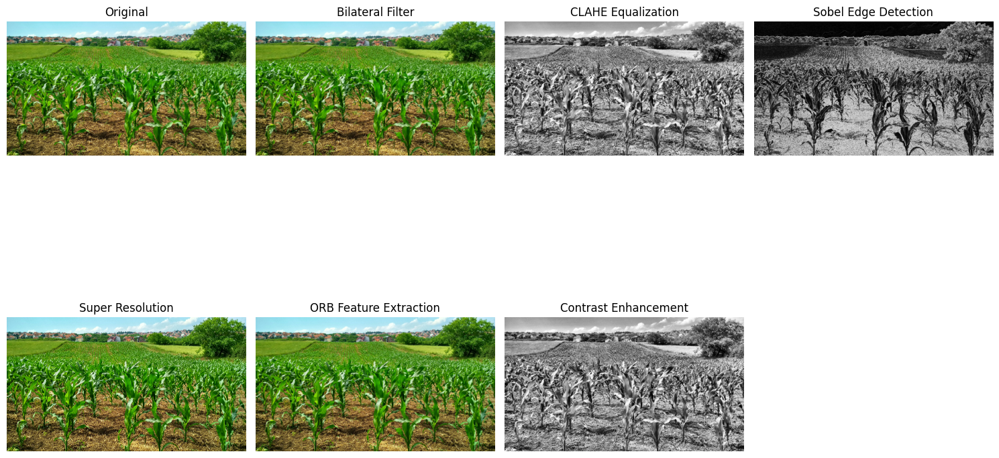

Displaying processed results for Manufacturing Image:


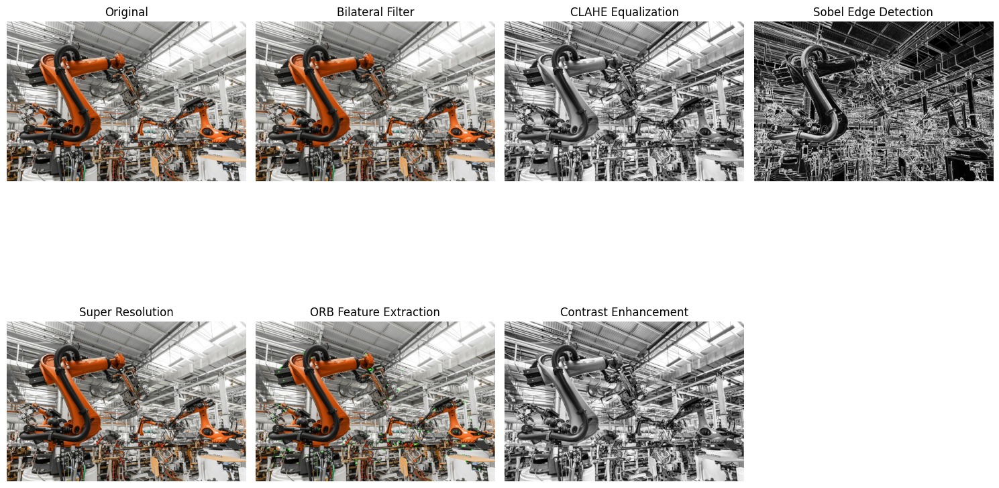

Displaying processed results for Road Image:


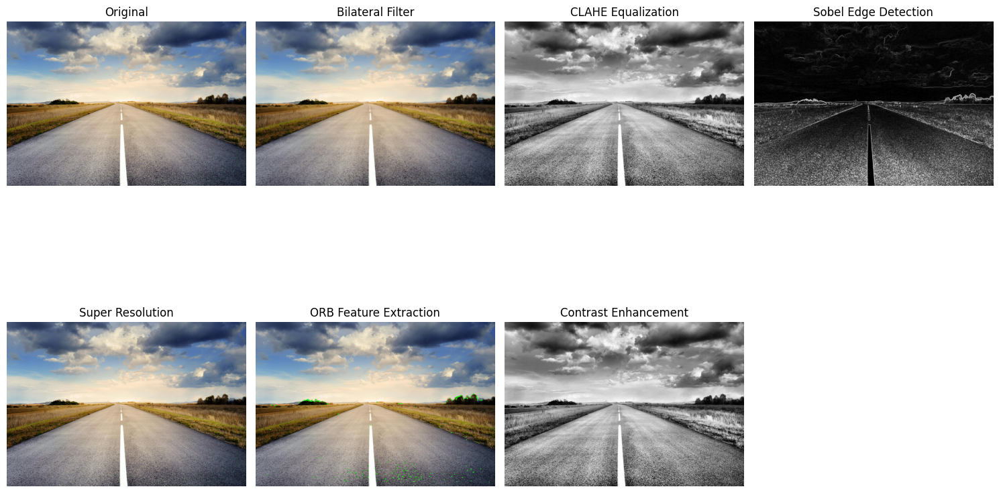

Displaying processed results for Medical Image:


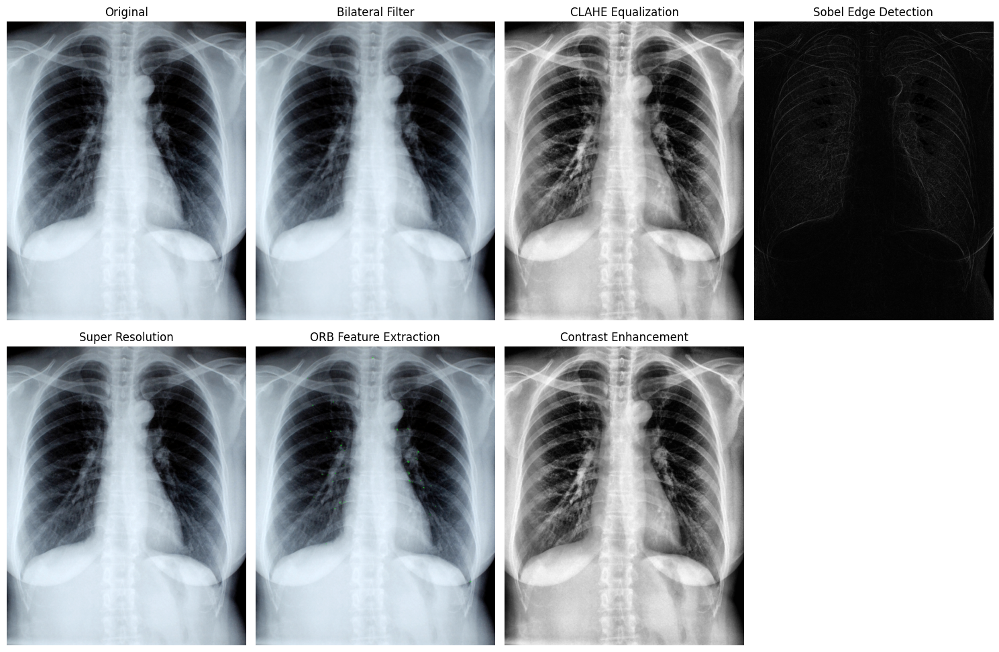

Displaying processed results for Satellite Image:


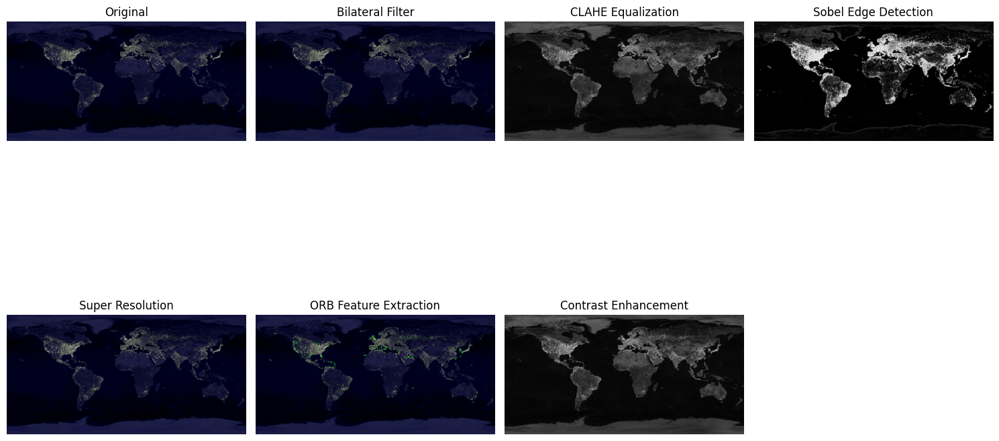

In [4]:
# Advanced Noise Reduction: Bilateral Filter
def bilateral_filter(image):
    return cv2.bilateralFilter(image, 9, 75, 75)

# Adaptive Histogram Equalization (CLAHE)
def clahe_equalization(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    return clahe.apply(gray)

# Sobel Edge Detection
def sobel_edge_detection(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)
    return cv2.magnitude(sobel_x, sobel_y)

# Image Super-Resolution (Simple Example with Upscaling)
def super_resolution(image):
    return cv2.resize(image, None, fx=2, fy=2, interpolation=cv2.INTER_CUBIC)

# Feature Extraction (ORB)
def extract_orb_features(image):
    orb = cv2.ORB_create()
    keypoints, descriptors = orb.detectAndCompute(image, None)
    return cv2.drawKeypoints(image, keypoints, None, color=(0,255,0))

# Contrast Enhancement (Adaptive Histogram Equalization - CLAHE)
def enhance_contrast(image):
    return clahe_equalization(image)

# Convert images to uint8 format for proper display
def convert_to_uint8(image):
    if image.dtype != np.uint8:
        image = np.uint8(np.clip(image, 0, 255))
    return image

# Apply all the preprocessing techniques to each image
def process_image(image):
    return {
        "Original": image,
        "Bilateral Filter": convert_to_uint8(bilateral_filter(image)),
        "CLAHE Equalization": convert_to_uint8(clahe_equalization(image)),
        "Sobel Edge Detection": convert_to_uint8(sobel_edge_detection(image)),
        "Super Resolution": convert_to_uint8(super_resolution(image)),
        "ORB Feature Extraction": convert_to_uint8(extract_orb_features(image)),
        "Contrast Enhancement": convert_to_uint8(enhance_contrast(image))
    }

# Process each of the uploaded images
agriculture_results = process_image(agriculture)
manufacturing_results = process_image(manufacturing)
road_results = process_image(road)
medical_results = process_image(medical)
satellite_results = process_image(satellite)

# Example function to display all images
def display_images(results):
    plt.figure(figsize=(15, 10))
    for idx, (title, img) in enumerate(results.items()):
        plt.subplot(2, 4, idx + 1)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(title)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

# Display results for each image
print("Displaying processed results for Agriculture Image:")
display_images(agriculture_results)

print("Displaying processed results for Manufacturing Image:")
display_images(manufacturing_results)

print("Displaying processed results for Road Image:")
display_images(road_results)

print("Displaying processed results for Medical Image:")
display_images(medical_results)

print("Displaying processed results for Satellite Image:")
display_images(satellite_results)

Results for Agriculture:


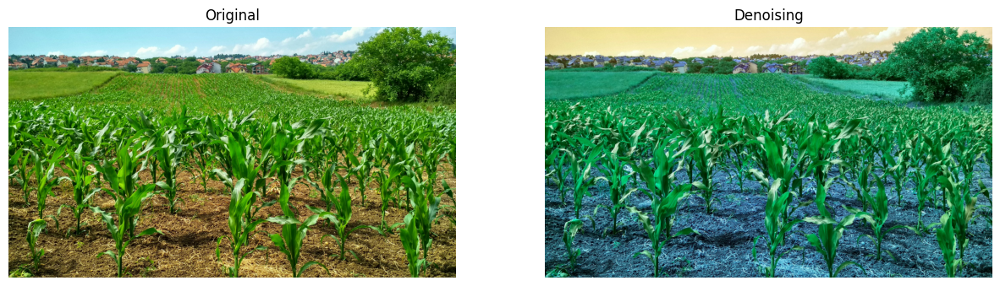

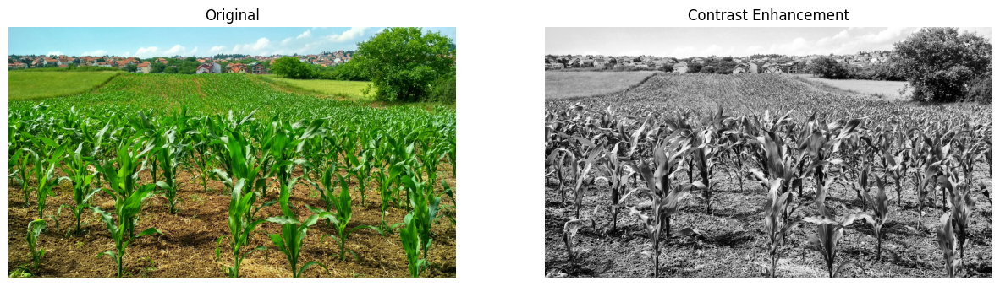

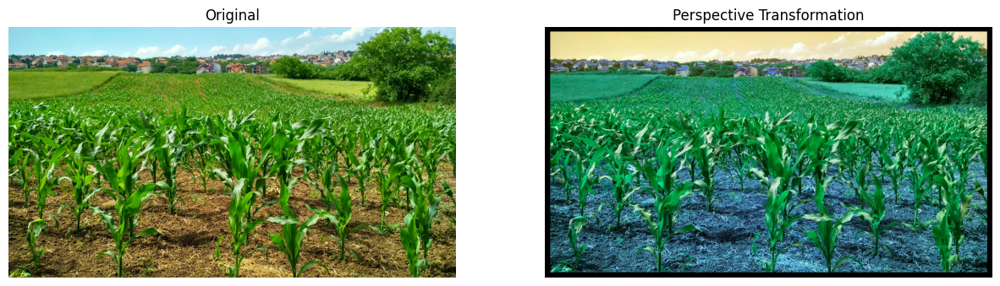

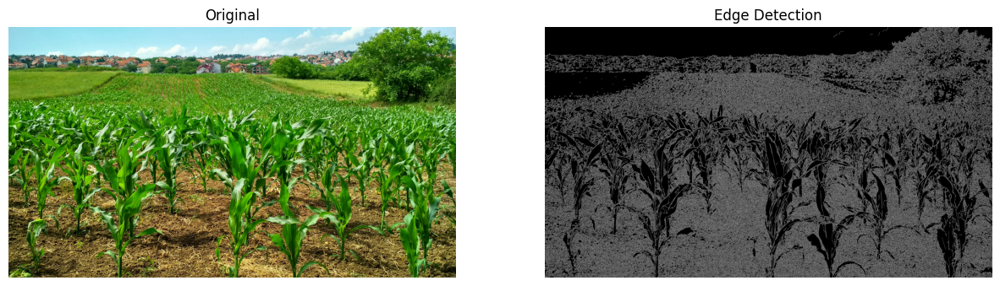

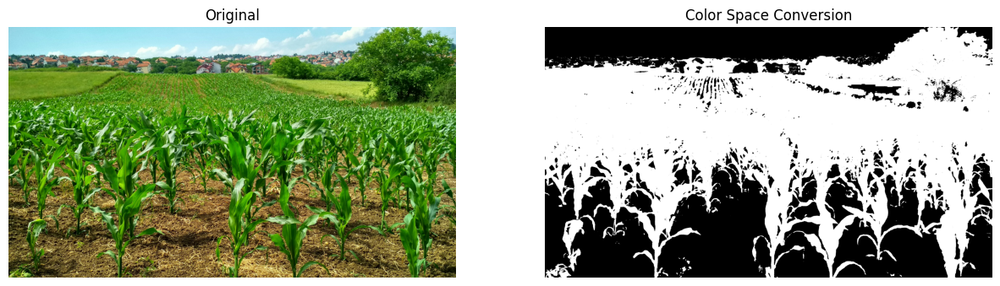

Results for Manufacturing:


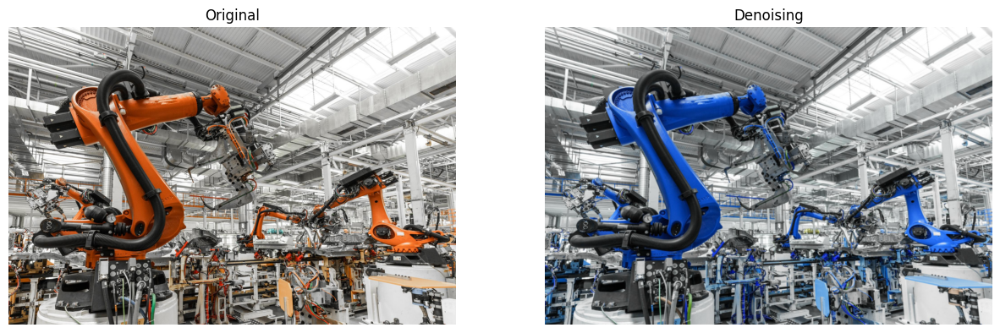

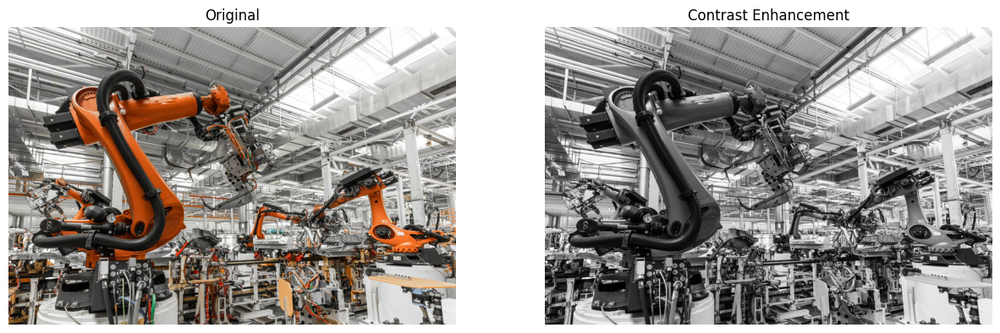

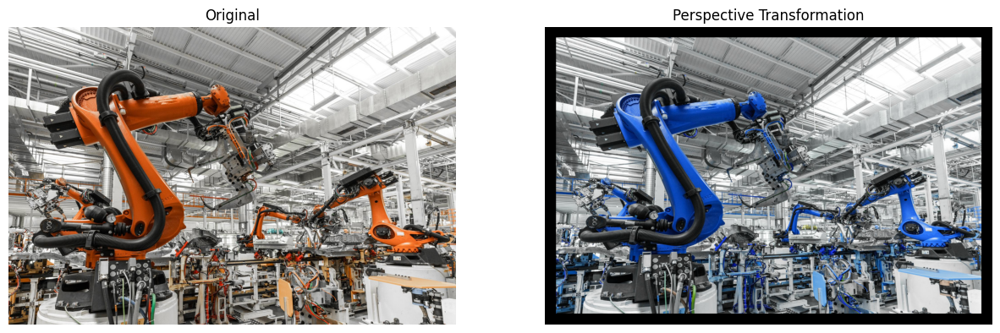

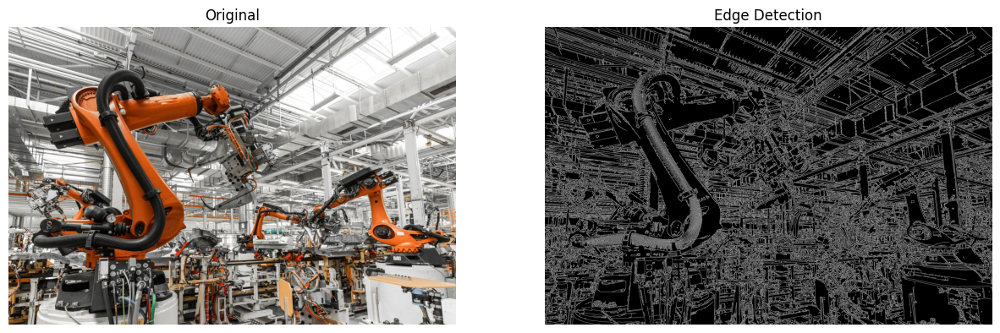

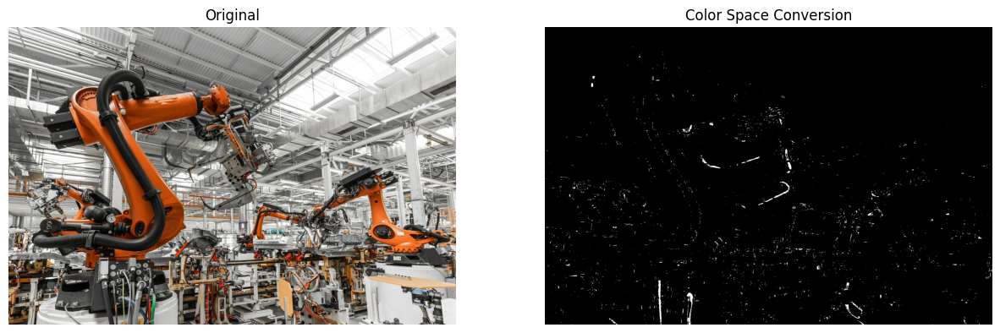

Results for Road:


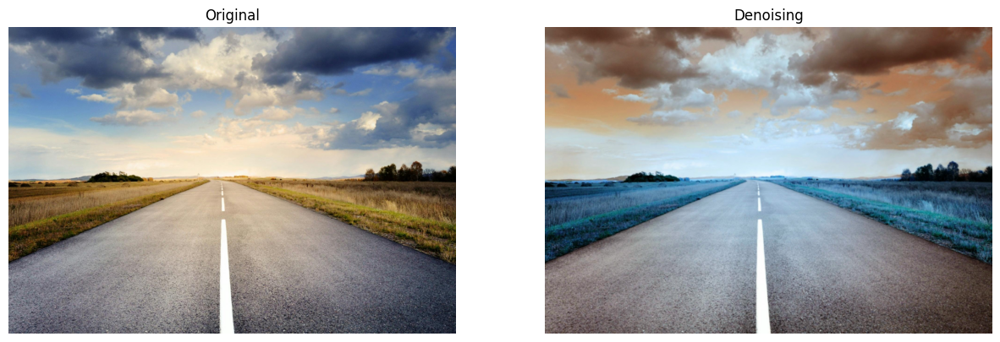

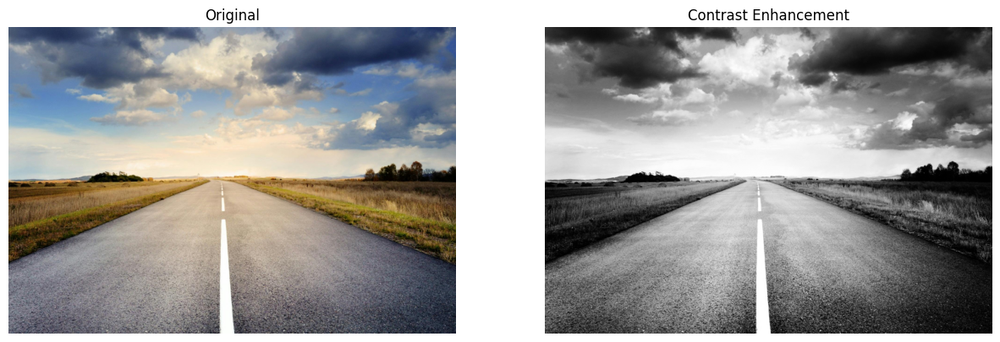

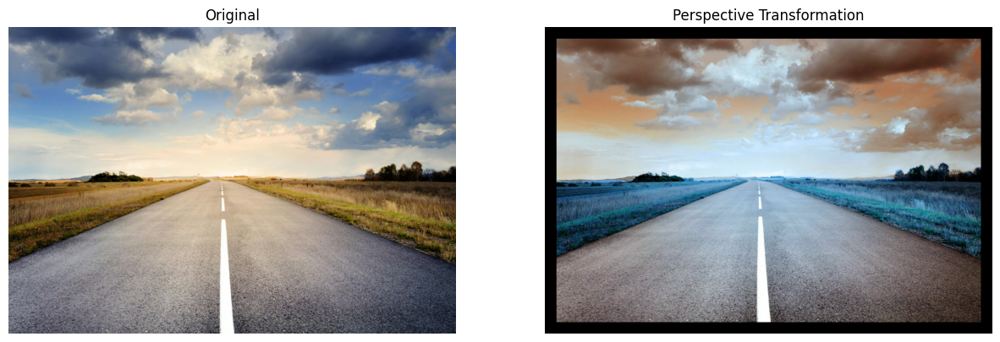

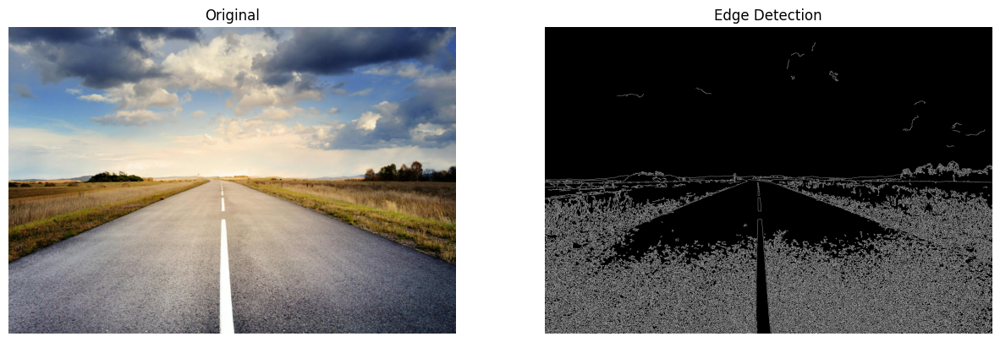

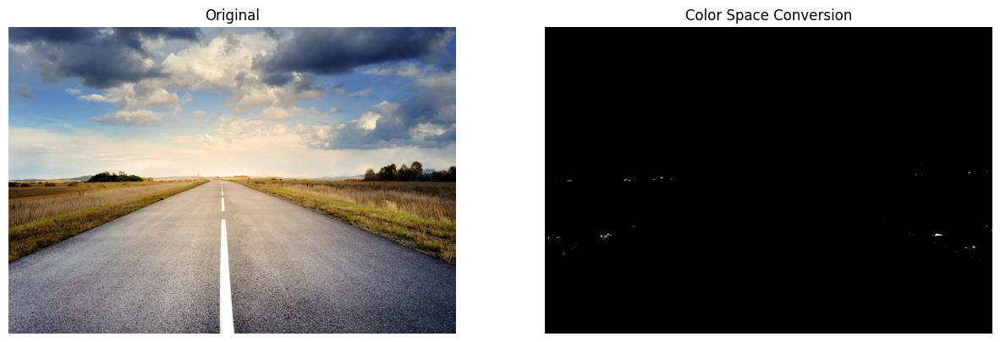

Results for Medical:


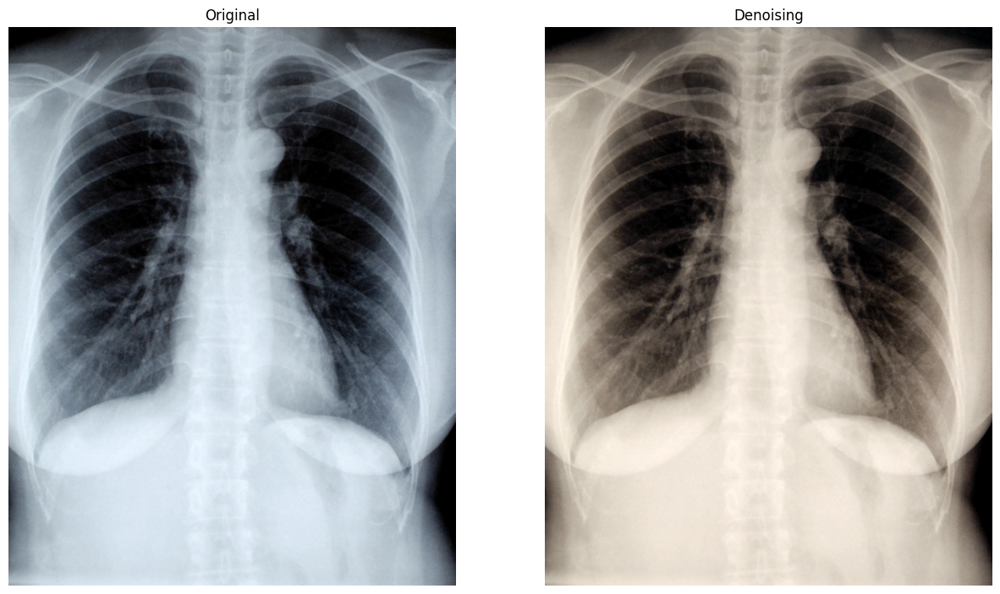

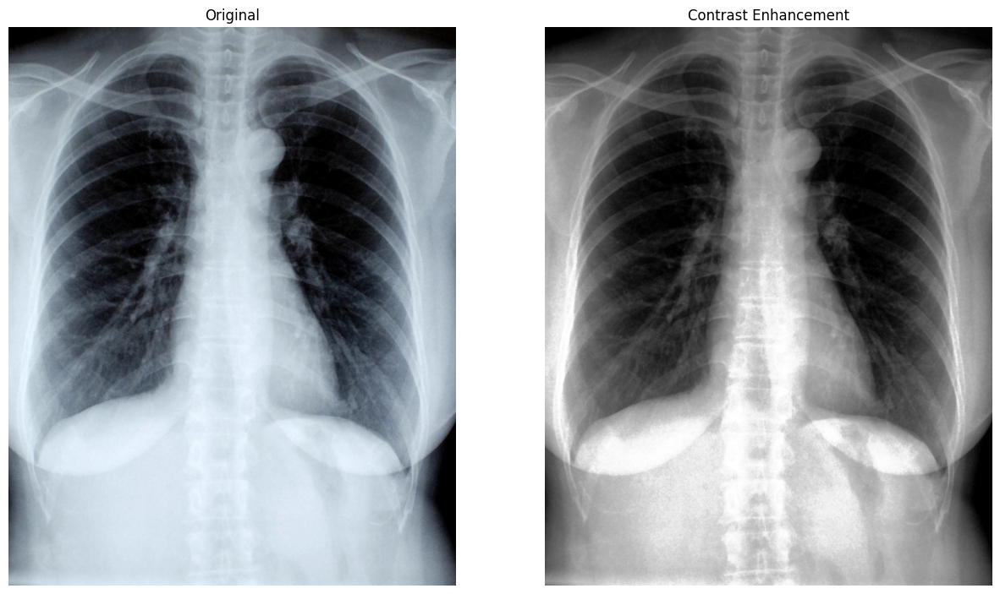

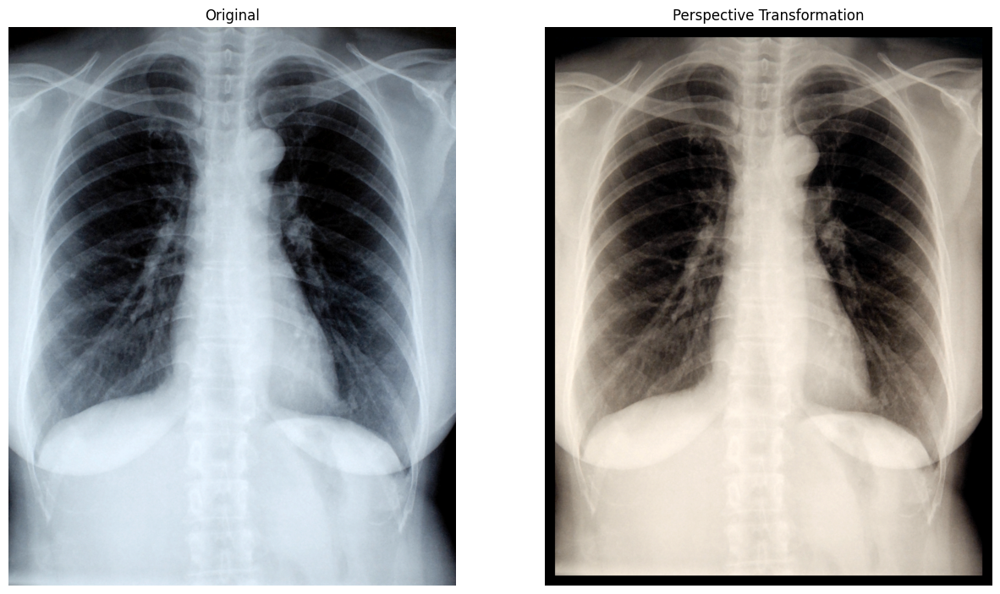

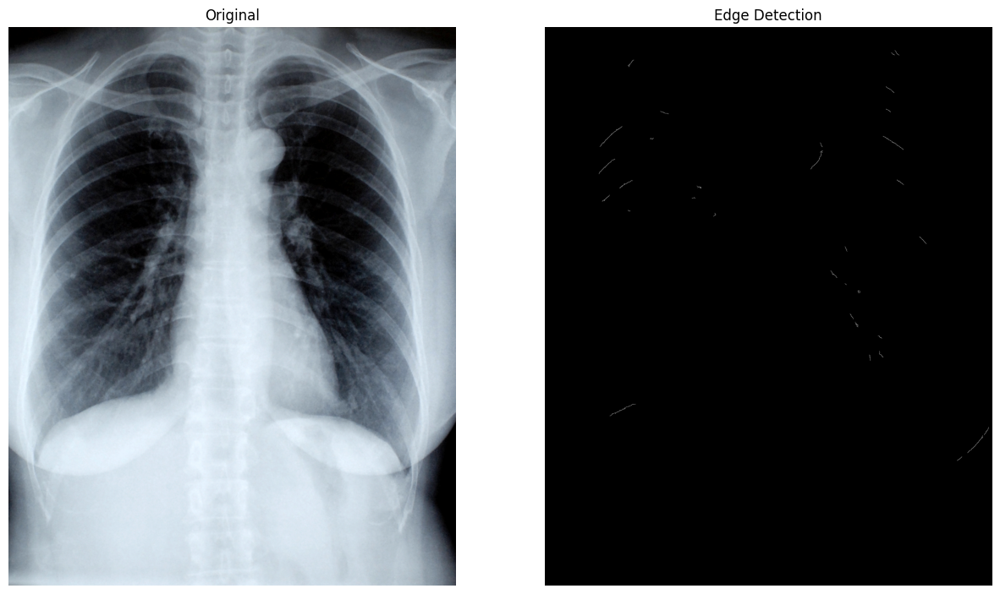

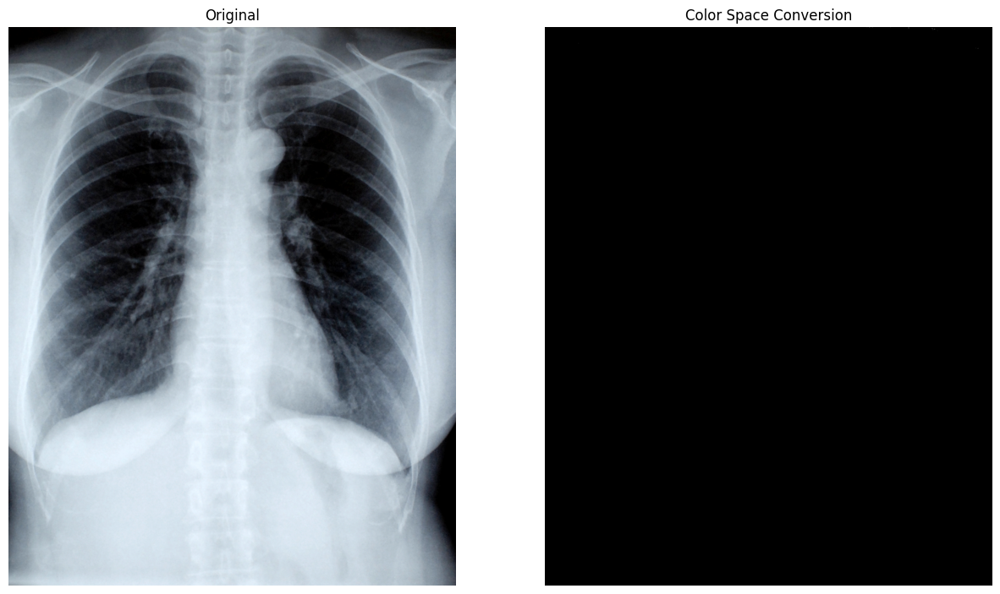

Results for Satellite:


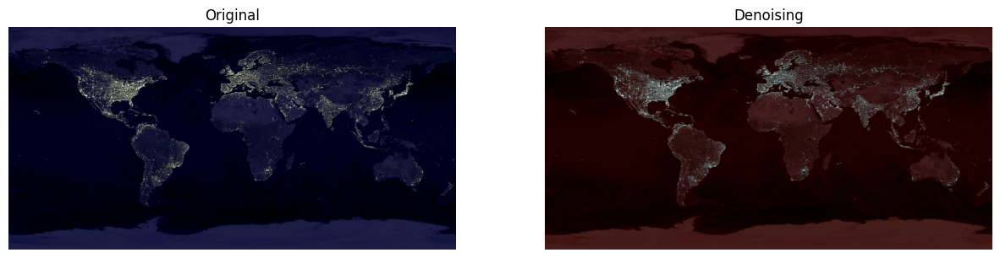

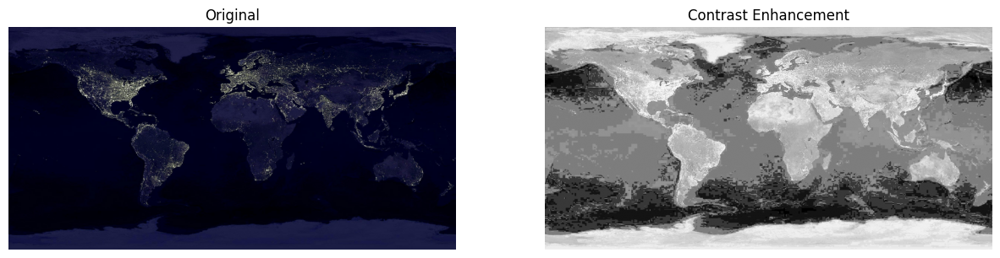

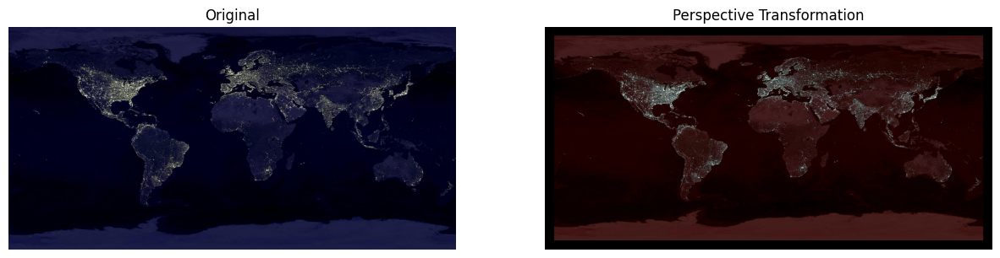

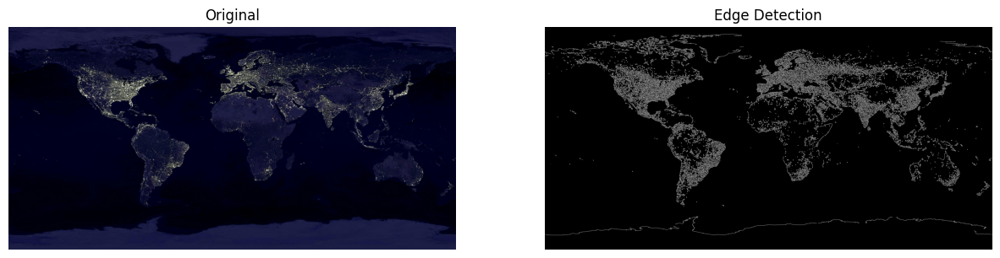

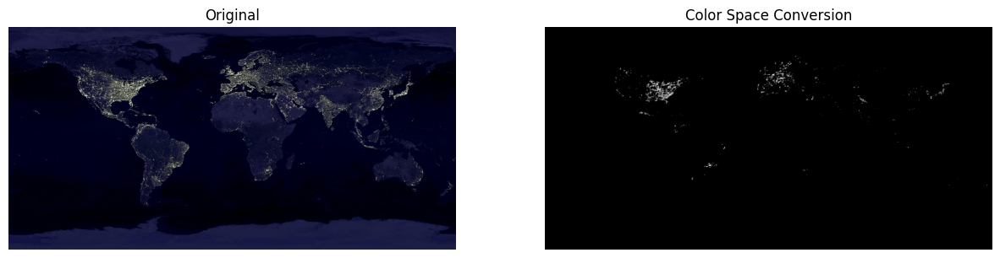

In [5]:
### Code
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Utility function to display images
def display_images(images, titles, cmap=None, figsize=(15, 10)):
    plt.figure(figsize=figsize)
    for i, image in enumerate(images):
        plt.subplot(1, len(images), i + 1)
        plt.imshow(image, cmap=cmap if len(image.shape) == 2 else None)
        plt.title(titles[i])
        plt.axis("off")
    plt.show()




# Preprocessing Functions
# Denoising - Gaussian Blur
def denoise_image(image):
    return cv2.GaussianBlur(image, (5, 5), 0)

# Contrast Enhancement - Histogram Equalization (grayscale example)
def enhance_contrast(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    return cv2.equalizeHist(gray)

# Perspective Transformation
def perspective_transform(image):
    height, width = image.shape[:2]
    src_points = np.float32([[0, 0], [width - 1, 0], [0, height - 1], [width - 1, height - 1]])
    dst_points = np.float32([[50, 50], [width - 50, 50], [50, height - 50], [width - 50, height - 50]])
    matrix = cv2.getPerspectiveTransform(src_points, dst_points)
    return cv2.warpPerspective(image, matrix, (width, height))

# Edge Detection - Canny
def detect_edges(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    return cv2.Canny(gray, 50, 150)

# Color Space Conversion - RGB to HSV and thresholding
def color_space_conversion(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    return cv2.inRange(hsv, (36, 25, 25), (70, 255, 255))  # Green mask

# Apply preprocessing on the images
# Apply all preprocessing techniques to each image
processed_images = {
    "agriculture": {
        "Denoising": denoise_image(agriculture),
        "Contrast Enhancement": enhance_contrast(agriculture),
        "Perspective Transformation": perspective_transform(agriculture),
        "Edge Detection": detect_edges(agriculture),
        "Color Space Conversion": color_space_conversion(agriculture),
    },
    "manufacturing": {
        "Denoising": denoise_image(manufacturing),
        "Contrast Enhancement": enhance_contrast(manufacturing),
        "Perspective Transformation": perspective_transform(manufacturing),
        "Edge Detection": detect_edges(manufacturing),
        "Color Space Conversion": color_space_conversion(manufacturing),
    },
    "road": {
        "Denoising": denoise_image(road),
        "Contrast Enhancement": enhance_contrast(road),
        "Perspective Transformation": perspective_transform(road),
        "Edge Detection": detect_edges(road),
        "Color Space Conversion": color_space_conversion(road),
    },
    "medical": {
        "Denoising": denoise_image(medical),
        "Contrast Enhancement": enhance_contrast(medical),
        "Perspective Transformation": perspective_transform(medical),
        "Edge Detection": detect_edges(medical),
        "Color Space Conversion": color_space_conversion(medical),
    },
    "satellite": {
        "Denoising": denoise_image(satellite),
        "Contrast Enhancement": enhance_contrast(satellite),
        "Perspective Transformation": perspective_transform(satellite),
        "Edge Detection": detect_edges(satellite),
        "Color Space Conversion": color_space_conversion(satellite),
    },
}

# Display results for each preprocessing applied to each image
for image_name, preprocessing_results in processed_images.items():
    print(f"Results for {image_name.capitalize()}:")
    for preprocessing_name, processed_image in preprocessing_results.items():
        display_images(
            [cv2.cvtColor(eval(image_name), cv2.COLOR_BGR2RGB), processed_image],
            ["Original", preprocessing_name],
            cmap="gray" if len(processed_image.shape) == 2 else None,
        )

Results for Agriculture:


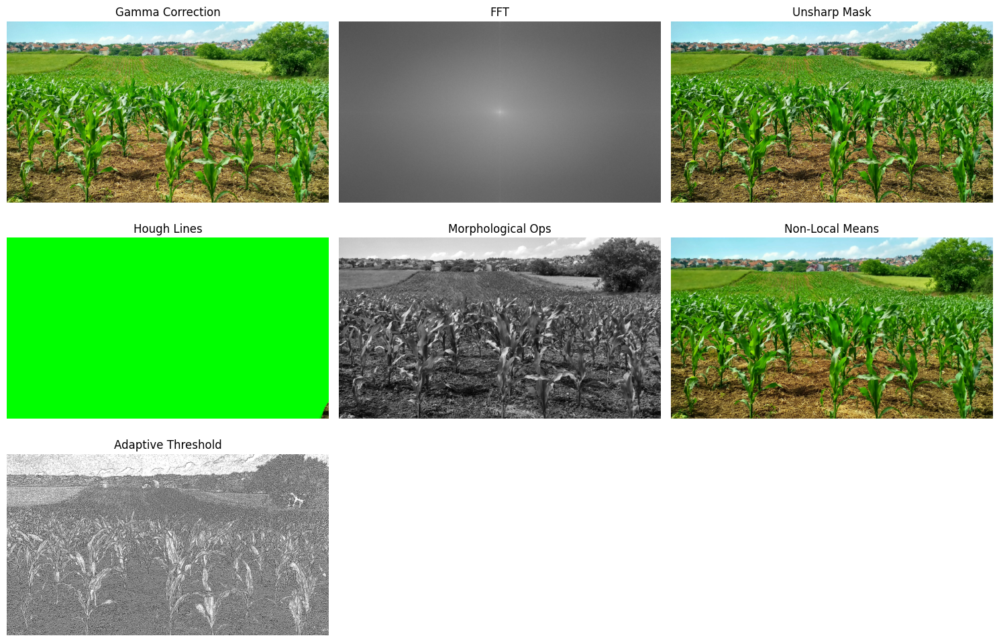

Results for Manufacturing:


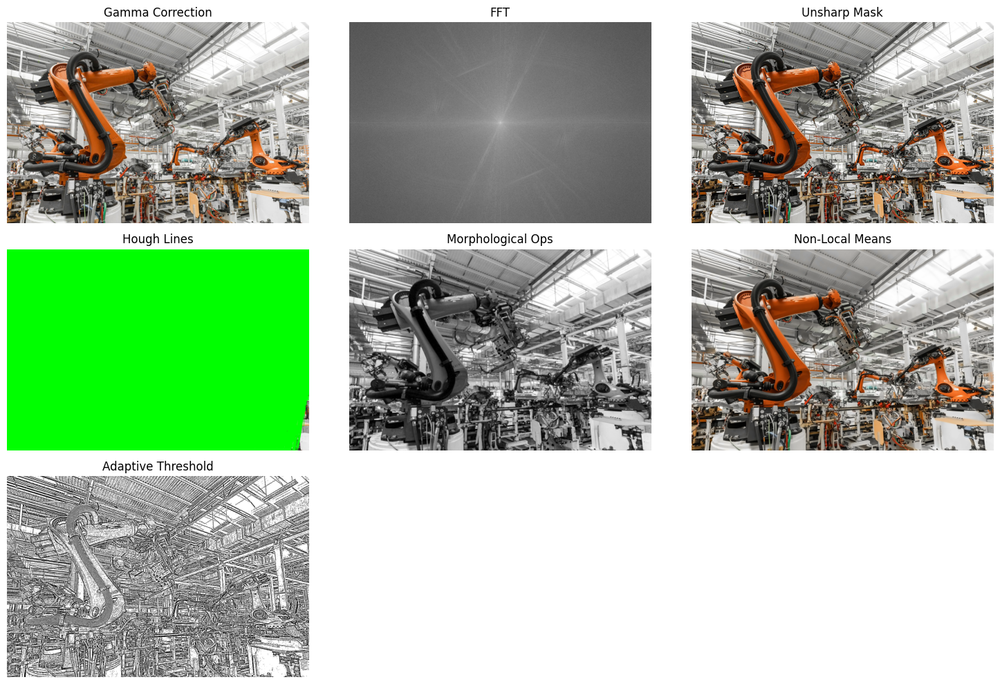

Results for Road:


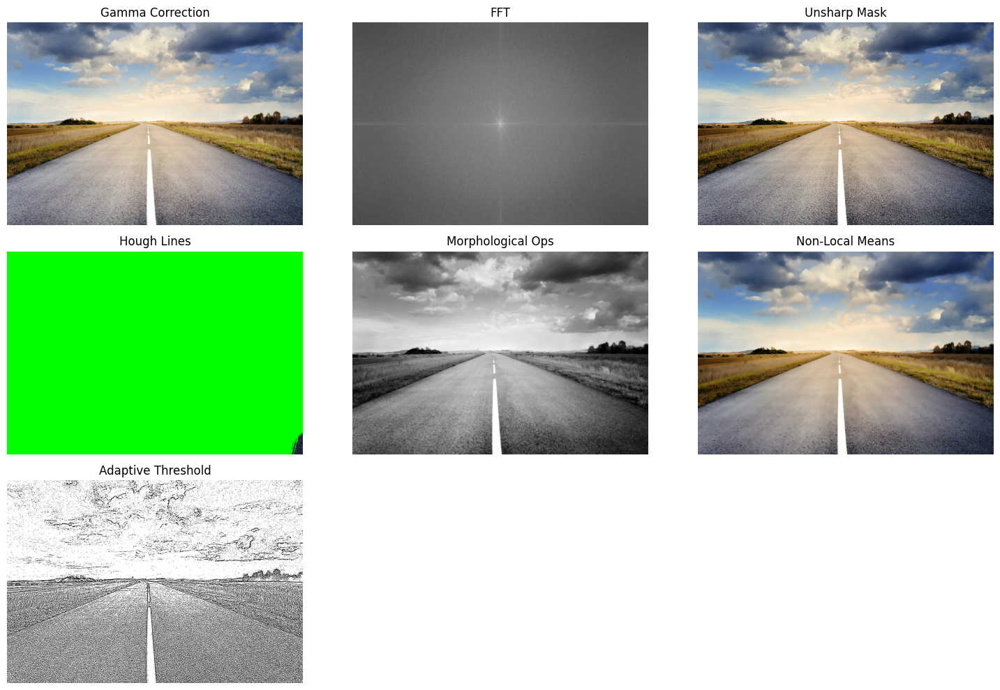

Results for Medical:


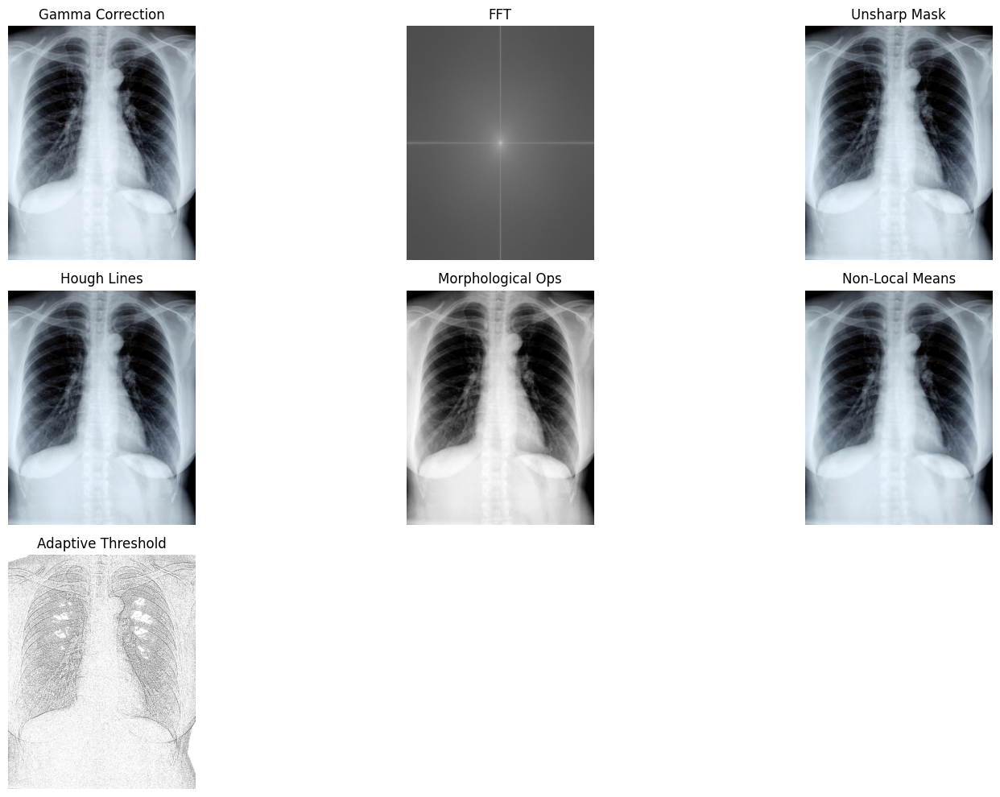

Results for Satellite:


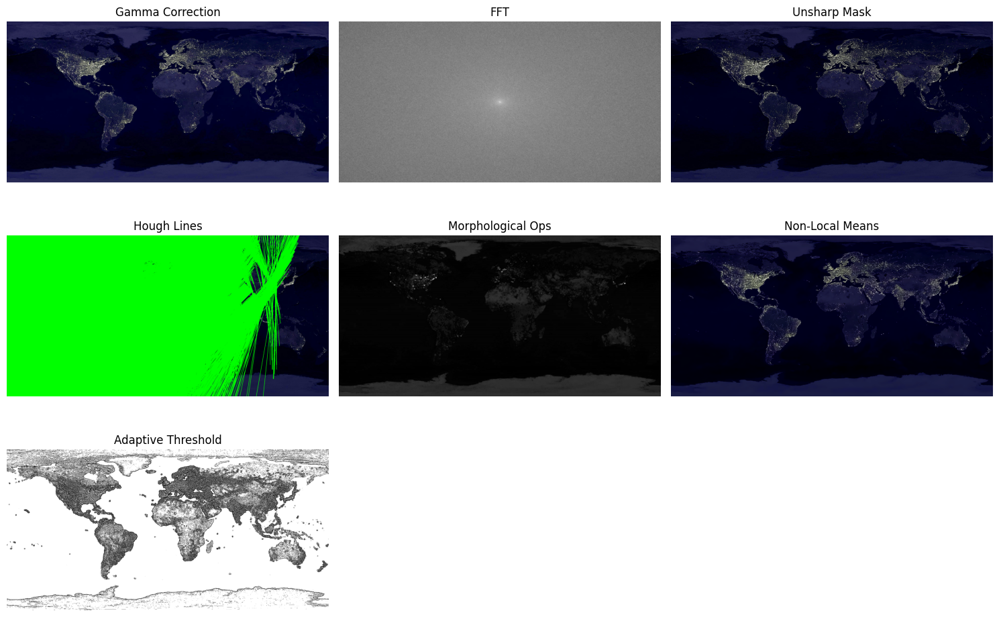

In [2]:
# Preprocessing Functions

# 1. Gamma Correction
def gamma_correction(image, gamma=1.2):
    inv_gamma = 1.0 / gamma
    table = np.array([(i / 255.0) ** inv_gamma * 255 for i in np.arange(256)]).astype("uint8")
    return cv2.LUT(image, table)

# 2. Fourier Transform for Frequency Analysis
def apply_fft(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    f = np.fft.fft2(gray)
    fshift = np.fft.fftshift(f)
    magnitude_spectrum = 20 * np.log(np.abs(fshift))
    return magnitude_spectrum

# 3. Unsharp Masking
def unsharp_mask(image, alpha=1.5, beta=-0.5):
    blurred = cv2.GaussianBlur(image, (9, 9), 10.0)
    sharpened = cv2.addWeighted(image, alpha, blurred, beta, 0)
    return sharpened

# 4. Hough Line Transform
def hough_line_detection(image):
    edges = cv2.Canny(cv2.cvtColor(image, cv2.COLOR_BGR2GRAY), 50, 150)
    lines = cv2.HoughLines(edges, 1, np.pi / 180, 100)
    result = image.copy()
    if lines is not None:
        for rho, theta in lines[:, 0]:
            a, b = np.cos(theta), np.sin(theta)
            x0, y0 = a * rho, b * rho
            x1, y1 = int(x0 + 1000 * (-b)), int(y0 + 1000 * a)
            x2, y2 = int(x0 - 1000 * (-b)), int(y0 - 1000 * a)
            cv2.line(result, (x1, y1), (x2, y2), (0, 255, 0), 2)
    return result

# 5. Morphological Transformations
def morphological_operations(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    kernel = np.ones((5, 5), np.uint8)
    opening = cv2.morphologyEx(gray, cv2.MORPH_OPEN, kernel)
    return opening

# 6. Histogram Matching
def histogram_matching(image, reference):
    matched = match_histograms(image, reference, multichannel=True)
    return matched

# 7. Non-Local Means Denoising
def non_local_means(image):
    return cv2.fastNlMeansDenoisingColored(image, None, 10, 10, 7, 21)

# 8. Watershed Segmentation
def watershed_segmentation(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    _, binary = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
    kernel = np.ones((3, 3), np.uint8)
    opening = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    sure_bg = cv2.dilate(opening, kernel, iterations=3)
    dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
    _, sure_fg = cv2.threshold(dist_transform, 0.7 * dist_transform.max(), 255, 0)
    unknown = cv2.subtract(sure_bg, sure_fg.astype(np.uint8))
    markers = cv2.connectedComponents(sure_fg.astype(np.uint8))[1]
    markers = markers + 1
    markers[unknown == 255] = 0
    result = cv2.watershed(image, markers)
    return result

# 9. Dense Optical Flow (Requires two images)
def optical_flow(image1, image2):
    gray1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)
    flow = cv2.calcOpticalFlowFarneback(gray1, gray2, None, 0.5, 3, 15, 3, 5, 1.2, 0)
    return flow

# 10. Adaptive Thresholding
def adaptive_threshold(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    return cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                 cv2.THRESH_BINARY, 11, 2)

# Apply all preprocessing techniques to each image
images = {"agriculture": agriculture, "manufacturing": manufacturing, "road": road,
          "medical": medical, "satellite": satellite}

results = {}
for name, image in images.items():
    results[name] = {
        "Gamma Correction": gamma_correction(image),
        "FFT": apply_fft(image),
        "Unsharp Mask": unsharp_mask(image),
        "Hough Lines": hough_line_detection(image),
        "Morphological Ops": morphological_operations(image),
        "Non-Local Means": non_local_means(image),
        "Adaptive Threshold": adaptive_threshold(image)
    }

# Visualization Function
def display_results(results):
    for image_name, preprocess_results in results.items():
        print(f"Results for {image_name.capitalize()}:")
        plt.figure(figsize=(15, 10))
        for i, (method, result) in enumerate(preprocess_results.items()):
            plt.subplot(3, 3, i + 1)
            if len(result.shape) == 2:  # Grayscale image
                plt.imshow(result, cmap="gray")
            else:
                plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
            plt.title(method)
            plt.axis("off")
        plt.tight_layout()
        plt.show()

# Display results
display_results(results)
